# Baseline investigation notebook 

In this notebook we are investigating if can we perform a classfication between baseline and sudoku between subjects. 

The CSV for the training is obtained by Davide's data merging all the generic baseline tasks and the sudoku tasks. 

#### Precprocessing:

    -  Logarithm trasnformation 
    -  Outlier elimination 
    -  Baseline average subtraction  
    -  Elimination of the subject F44 
    
##### Classification 
    - SVM 
    - Random Forest Classifier 
    
   
   
##### Feature importance  

Prediction is not reasoning  

----------------------------------------
    - Visual inspection of the PDF 
    - Permutation importance 
    
    


In [2]:
import json 
import os
import pandas as pd
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt
import math 
import numpy as np
import pickle


In [8]:
# Get the current directory (where your Python script is located)
current_directory = os.path.dirname('Baseline_Investigation')

csv_file_path = os.path.join(current_directory, 'DB_Macchinine', 'Dati Pow Aggregati','DATA_DBMACCHINE_AGGREGATI_BASELINE_FOCUS.csv')
print(csv_file_path) 

df = pd.read_csv(csv_file_path)

df.head()

DB_Macchinine\Dati Pow Aggregati\DATA_DBMACCHINE_AGGREGATI_BASELINE_FOCUS.csv


,UserID,Phase,AF3_Theta,AF3_Alpha,AF3_BetaL,AF3_BetaH,AF3_Gamma,T7_Theta,T7_Alpha,T7_BetaL,...,T8_Theta,T8_Alpha,T8_BetaL,T8_BetaH,T8_Gamma,AF4_Theta,AF4_Alpha,AF4_BetaL,AF4_BetaH,AF4_Gamma
0,M28,Baseline,2.491,2.108,0.544,2.437,0.562,1.331,0.485,0.487,...,1.720,1.423,1.564,4.624,1.890,4.469,2.610,0.486,2.134,0.673
1,M28,Baseline,2.569,2.127,0.651,2.522,0.567,1.193,0.401,0.616,...,1.719,1.378,1.534,3.993,1.575,4.383,2.534,0.490,2.117,0.685
2,M28,Baseline,2.562,2.233,0.876,2.536,0.595,1.098,0.317,0.745,...,1.710,1.440,1.466,3.279,1.221,4.062,2.544,0.627,2.064,0.718
3,M28,Baseline,2.476,2.419,1.160,2.468,0.655,1.143,0.274,0.865,...,1.634,1.596,1.365,2.691,0.932,3.547,2.690,0.827,1.983,0.780
4,M28,Baseline,2.501,2.645,1.439,2.328,0.740,1.304,0.311,0.978,...,1.524,1.821,1.257,2.340,0.761,3.215,2.957,1.040,1.886,0.855


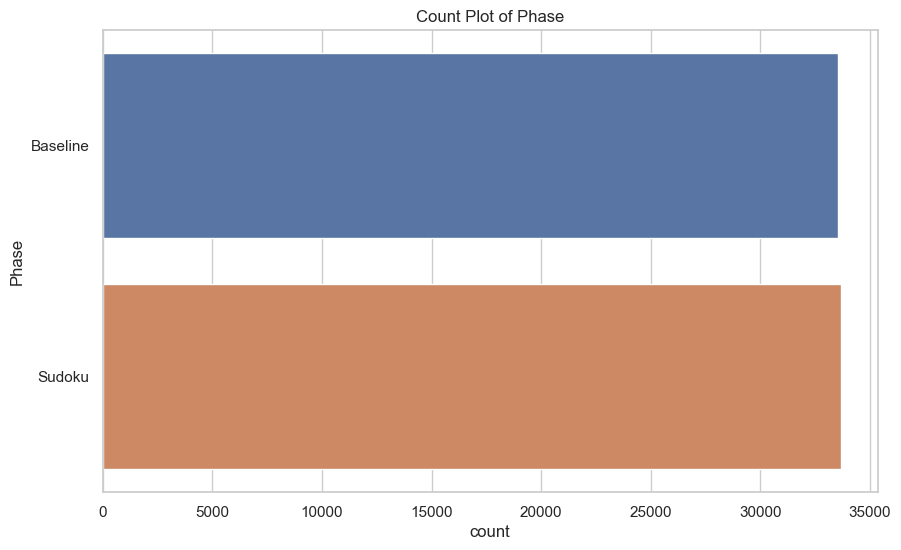

In [9]:
#Visualize Class Counts
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

# Use Seaborn's countplot to create the plot
sns.countplot(y='Phase', data=df)

plt.title('Count Plot of Phase')
plt.show()

In [10]:
def find_and_print_outliers(df,a):
    outlier_rows = set()  # Set to store the indices of rows with at least one outlier

    for column in df.columns:
        if df[column].dtype in ['int64', 'float64']:  # Check if the column is numeric
            Q1 = df[column].quantile(0.25)  # First quartile (25%)
            Q3 = df[column].quantile(0.75)  # Third quartile (75%)
            IQR = Q3 - Q1  # Interquartile range

            # Define the range for outliers
            lower_bound = Q1 - a * IQR
            upper_bound = Q3 + a * IQR

            # Find the outliers
            outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]

            # Print the percentage of outliers
            print(f'Percentage of outliers in {column}: {len(outliers) / len(df) * 100}%')

            # Add the indices of the outlier rows to the set
            outlier_rows.update(outliers.index)

    # Print the number of rows with at least one outlier
    print(f'Percentage of rows with at least one outlier: {len(outlier_rows) / len(df) * 100}%')
    df.drop(outlier_rows)
    
    return df

def process_data(df):
    data_columns = [
        'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma',
        'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma',
        'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma',
        'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma',
        'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma'
    ]

    # Conversion to float64
    df[data_columns] = df[data_columns].astype(float)

    # Apply logarithm
    df.loc[:, data_columns] = df.loc[:, data_columns].apply(lambda x: x.apply(lambda y: math.log(y + 1)))

    # Subtract average baseline value for each specific user
    label_column = 'Phase'
    user_id_column = 'UserID'

    # Get the unique user IDs
    user_ids = df[user_id_column].unique()

    # Process the data for each user ID
    for user_id in user_ids:
        print(f"Processing user ID: {user_id}")  # Print the current user ID

        # Get the rows for the current user ID
        user_rows = df[df[user_id_column] == user_id]

        # Calculate the average value for each specified column, for rows with the label 'baseline'
        baseline_rows = user_rows[user_rows[label_column] == 'Baseline']
        if baseline_rows.empty:
            print(f"No 'baseline' rows for user ID: {user_id}")  # Print a message if there are no 'baseline' rows
            continue
        averages = baseline_rows[data_columns].mean()

        # Subtract the average value from each column, for rows with the current user ID
        for column in data_columns:
            df.loc[user_rows.index, column] -= averages[column]
            
    ## removin outliers
    df = find_and_print_outliers(df,1.5)
    return df

In [11]:
df_processed= process_data(df)

Processing user ID: M28
Processing user ID: F44
Processing user ID: F25
Processing user ID: M23
Processing user ID: F24
Processing user ID: F20
Processing user ID: F23
Processing user ID: M21
Processing user ID: M22
Processing user ID: M25
Processing user ID: F28
Processing user ID: M29
Processing user ID: M26
Processing user ID: F26
Processing user ID: M27
Processing user ID: F27
Processing user ID: F60
Processing user ID: M30
Percentage of outliers in AF3_Theta: 2.8380932537615524%
Percentage of outliers in AF3_Alpha: 3.742949414373521%
Percentage of outliers in AF3_BetaL: 3.9825577069039926%
Percentage of outliers in AF3_BetaH: 7.279032042028187%
Percentage of outliers in AF3_Gamma: 11.048769961156669%
Percentage of outliers in T7_Theta: 7.729971872070007%
Percentage of outliers in T7_Alpha: 6.333993124283779%
Percentage of outliers in T7_BetaL: 5.665768755673954%
Percentage of outliers in T7_BetaH: 6.807256708288066%
Percentage of outliers in T7_Gamma: 9.267334394951856%
Percentage

In [12]:
df_processed

,UserID,Phase,AF3_Theta,AF3_Alpha,AF3_BetaL,AF3_BetaH,AF3_Gamma,T7_Theta,T7_Alpha,T7_BetaL,...,T8_Theta,T8_Alpha,T8_BetaL,T8_BetaH,T8_Gamma,AF4_Theta,AF4_Alpha,AF4_BetaL,AF4_BetaH,AF4_Gamma
0,M28,Baseline,-1.045857,-0.512508,-0.773521,0.287755,-0.197493,-0.895925,-0.893190,-0.695527,...,-0.758613,-0.661468,-0.279777,0.769820,0.343770,-0.531116,-0.374830,-0.856392,0.153530,-0.144022
1,M28,Baseline,-1.023760,-0.506414,-0.706516,0.312185,-0.194297,-0.956952,-0.951418,-0.612334,...,-0.758981,-0.680215,-0.291547,0.650814,0.228363,-0.546965,-0.396108,-0.853703,0.148091,-0.136875
2,M28,Baseline,-1.025723,-0.473077,-0.578755,0.316152,-0.176587,-1.001238,-1.013248,-0.535533,...,-0.762297,-0.654477,-0.318748,0.496496,0.080471,-0.608450,-0.393282,-0.765742,0.130941,-0.117479
3,M28,Baseline,-1.050163,-0.417140,-0.437789,0.296734,-0.139659,-0.980016,-1.046443,-0.469027,...,-0.790742,-0.592503,-0.360568,0.348674,-0.058930,-0.715744,-0.352912,-0.649804,0.104149,-0.082027
4,M28,Baseline,-1.042997,-0.353131,-0.316309,0.255528,-0.089575,-0.907576,-1.017814,-0.410202,...,-0.833400,-0.509383,-0.407309,0.248748,-0.151604,-0.791562,-0.283052,-0.539530,0.071091,-0.040755
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67188,M30,Sudoku,-0.981957,-0.248794,-0.161670,-0.028737,-0.064210,-0.744394,-0.118852,-0.153107,...,-0.471223,-0.558961,-0.240407,-0.091703,-0.124483,-0.657760,-0.397209,-0.300383,-0.178724,-0.095106
67189,M30,Sudoku,-0.932244,-0.259306,-0.171683,-0.024596,-0.054844,-0.739947,-0.079700,-0.150371,...,-0.492635,-0.686073,-0.267774,-0.098122,-0.132382,-0.567366,-0.372357,-0.295014,-0.160115,-0.087708
67190,M30,Sudoku,-0.834397,-0.283122,-0.188170,-0.031507,-0.048087,-0.726721,-0.054239,-0.140854,...,-0.496527,-0.788474,-0.298952,-0.122235,-0.141143,-0.474657,-0.371866,-0.281055,-0.148385,-0.083621
67191,M30,Sudoku,-0.729658,-0.348153,-0.207538,-0.046177,-0.047246,-0.710072,-0.055357,-0.124080,...,-0.473943,-0.848550,-0.333021,-0.157138,-0.145955,-0.377927,-0.405801,-0.266638,-0.144021,-0.084437


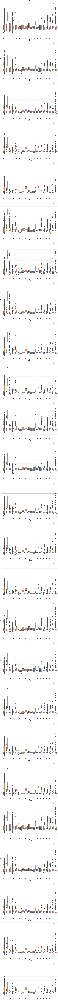

In [13]:
# Assuming filtered_df is your DataFrame and columns is the list of columns
columns = [
    'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma',
    'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma',
    'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma',
    'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma',
    'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma'
]

# Set the size of the entire plot
plt.figure(figsize=(15,256))

# Number of rows and columns for subplots
n_rows = 25
n_cols = 1

# Create subplots
for i, column in enumerate(columns, start=1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(data=df_processed, x="UserID", y=column, hue="Phase")
    plt.title(column)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

In [15]:
df_processed = df_processed[df_processed['UserID'] != 'F44']

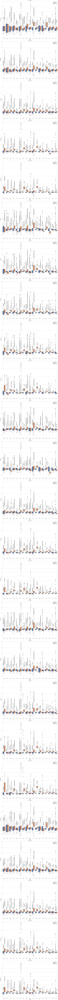

In [16]:
# Assuming filtered_df is your DataFrame and columns is the list of columns
columns = [
    'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma',
    'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma',
    'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma',
    'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma',
    'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma'
]

# Set the size of the entire plot
plt.figure(figsize=(15,256))

# Number of rows and columns for subplots
n_rows = 25
n_cols = 1

# Create subplots
for i, column in enumerate(columns, start=1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(data=df_processed, x="UserID", y=column, hue="Phase")
    plt.title(column)

# Adjust layout to prevent overlap
plt.tight_layout()

# Save the plot as a PDF
plt.savefig("output_plots.pdf")

# Show the plot
plt.show()

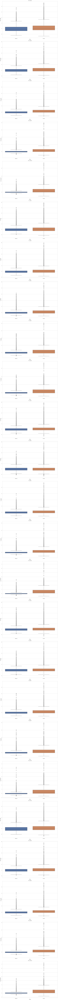

In [17]:
# Assuming filtered_df is your DataFrame and columns is the list of columns
columns = [
    'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma',
    'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma',
    'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma',
    'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma',
    'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma'
]

# Set the size of the entire plot
plt.figure(figsize=(15,256))

# Number of rows and columns for subplots
n_rows = 25
n_cols = 1

# Create subplots
for i, column in enumerate(columns, start=1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(data=df_processed, x="Phase", y=column)
    plt.title(column)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

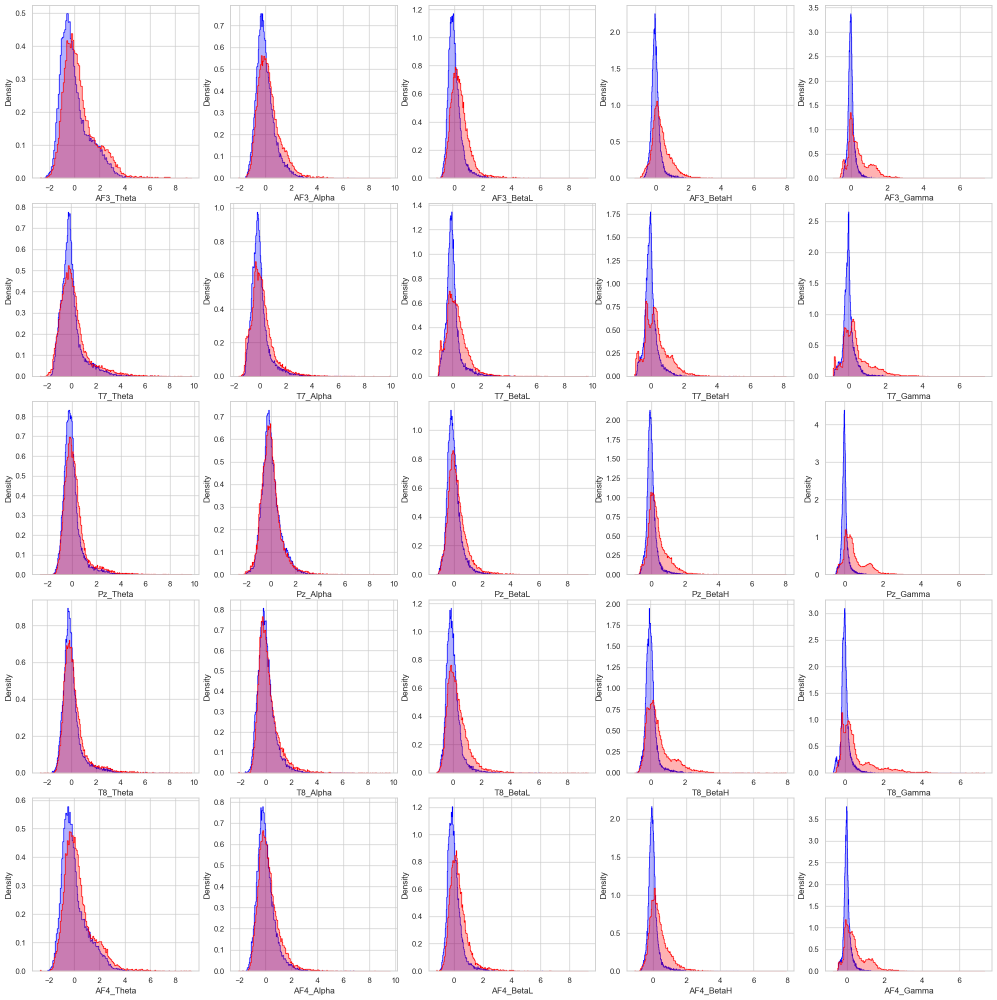

In [18]:
df_col = df_processed[columns]

X0 = df_col[df_processed['Phase']=='Baseline']
X1 = df_col[df_processed['Phase']=='Sudoku']

fig, axes = plt.subplots(ncols=5, nrows=5, figsize=(20,20))
fig.tight_layout()

for i, ax in zip(range(df_col.columns.size), axes.flat):
    sns.histplot(X0.iloc[:,i], color="blue", ax=ax, stat='density', element="step",  alpha=0.3)
    sns.histplot(X1.iloc[:,i], color="red",  ax=ax,stat='density', element="step",  alpha=0.3)

# Save the plot as a PDF
plt.savefig("channels.pdf")
plt.show()

In [11]:
#PCA fit
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(df_col)

#let's use the pca to transform the dataset
df_col_pca = pd.DataFrame(pca.transform(df_col))
df_col_pca.columns =['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10','PC11','PC12','PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20','PC21','PC22','PC23','PC24','PC25']


pd.DataFrame(pca.components_,index=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10','PC11','PC12','PC13','PC14','PC15','PC16','PC17','PC18','PC19','PC20','PC21','PC22','PC23','PC24','PC25'],columns=df_col.columns)

,AF3_Theta,AF3_Alpha,AF3_BetaL,AF3_BetaH,AF3_Gamma,T7_Theta,T7_Alpha,T7_BetaL,T7_BetaH,T7_Gamma,...,T8_Theta,T8_Alpha,T8_BetaL,T8_BetaH,T8_Gamma,AF4_Theta,AF4_Alpha,AF4_BetaL,AF4_BetaH,AF4_Gamma
PC1,0.301720,0.234418,0.185183,0.143773,0.121884,0.300933,0.240412,0.202927,0.165630,0.140687,...,0.250237,0.207008,0.186868,0.160325,0.147463,0.280683,0.217901,0.177064,0.142402,0.124599
PC2,-0.520371,-0.179157,-0.000410,0.123517,0.187530,0.001328,0.079675,0.132362,0.201633,0.250667,...,-0.102573,0.076660,0.142882,0.227471,0.292881,-0.438321,-0.120605,0.020341,0.126235,0.191378
PC3,0.356559,0.155348,0.100048,0.104461,0.170473,-0.454254,-0.271271,-0.097046,0.068807,0.182419,...,-0.279973,-0.137493,0.030956,0.169746,0.267305,0.210119,0.044804,0.041944,0.086475,0.169574
PC4,0.191211,-0.224296,-0.138819,-0.039507,0.047378,0.506183,0.193523,0.193885,0.194684,0.194421,...,-0.052682,-0.321382,-0.131264,-0.000226,0.100882,0.138815,-0.277544,-0.158273,-0.045466,0.049851
PC5,0.009978,-0.361031,-0.019265,-0.016829,-0.006537,-0.206066,-0.334389,-0.133715,-0.027093,-0.002938,...,0.501247,-0.042257,0.163250,0.122709,0.096609,0.117531,-0.313023,0.023875,0.031894,0.034370
PC6,-0.084561,-0.034805,0.465076,0.055629,-0.087086,-0.008264,0.032007,0.278541,0.008491,-0.139297,...,-0.054652,-0.200419,0.245633,-0.109074,-0.256220,-0.065945,-0.061042,0.464295,0.055701,-0.080200
PC7,-0.078476,0.093849,-0.040856,-0.157679,-0.125211,-0.014281,0.054906,0.004550,0.028376,0.051973,...,0.412804,0.438117,0.254505,0.148749,0.140902,-0.019141,0.160314,-0.005874,-0.120068,-0.087170
PC8,0.166622,-0.187453,-0.154926,-0.231728,-0.225108,-0.410751,0.209005,0.374472,0.317750,0.236193,...,-0.124518,0.107348,0.155258,-0.024192,-0.060767,0.117371,-0.165522,-0.105541,-0.228817,-0.212036
PC9,0.246132,-0.374835,-0.017755,0.084955,0.071798,0.247406,-0.097567,-0.118260,-0.238441,-0.208224,...,-0.073333,0.220096,0.247424,0.050795,0.029635,0.109984,-0.342593,0.037700,0.075044,0.054967
PC10,-0.014271,0.096870,0.095946,-0.459394,-0.015168,0.236327,-0.207686,-0.083368,-0.229983,0.173853,...,-0.220136,-0.077744,0.214840,-0.073103,0.360058,-0.060254,0.076847,0.123595,-0.411343,0.031984


In [12]:
pd.DataFrame(pca.explained_variance_).transpose()

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,9.449403,2.16706,1.05204,0.700389,0.413484,0.30624,0.251937,0.176493,0.143211,0.122283,...,0.053698,0.045939,0.034994,0.025603,0.019848,0.017332,0.016722,0.013143,0.010796,0.005358


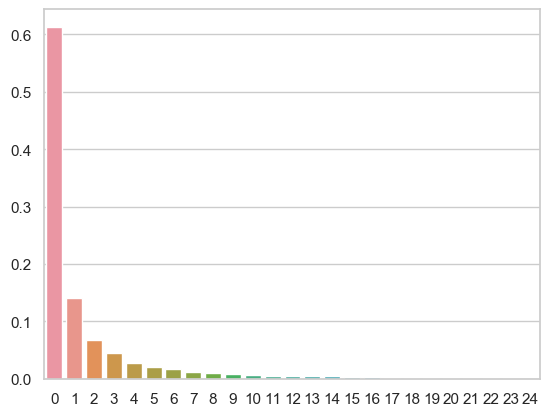

In [13]:
#VISUALIZE The percentage of variance explained by each of the selected components.
explained_var=pd.DataFrame(pca.explained_variance_ratio_).transpose()
ax = sns.barplot( data=explained_var)

In [14]:
cum_explained_var=np.cumsum(pca.explained_variance_ratio_)
cum_explained_var= pd.DataFrame(cum_explained_var).transpose()
cum_explained_var

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,0.613372,0.754038,0.822327,0.86779,0.89463,0.914508,0.930862,0.942318,0.951614,0.959552,...,0.987684,0.990666,0.992938,0.994599,0.995888,0.997013,0.998098,0.998951,0.999652,1.0


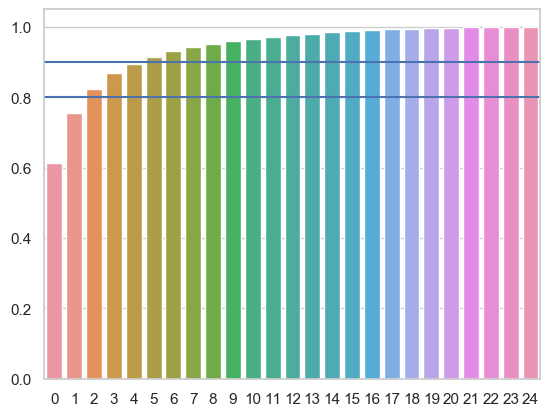

In [15]:
ax = sns.barplot(data=cum_explained_var)
ax.axhline(0.9)
ax.axhline(0.8)

In [17]:
import plotly.graph_objects as go

def myplot(score, coeff, labels=None):
    fig = go.Figure()

    xs = score[:, 0]
    ys = score[:, 1]
    zs = score[:, 2]

    n = coeff.shape[0]
    scalex = 1.0 / (xs.max() - xs.min())
    scaley = 1.0 / (ys.max() - ys.min())
    scalez = 1.0 / (zs.max() - zs.min())

    fig.add_trace(go.Scatter3d(
        x=xs * scalex,
        y=ys * scaley,
        z=zs * scalez,
        mode='markers',
        marker=dict(
            size=6,
            color='blue',  # You can customize the color
        ),
        text=labels
    ))

    for i in range(n):
        fig.add_trace(go.Cone(
            x=[0],
            y=[0],
            z=[0],
            u=[coeff[i, 0]],
            v=[coeff[i, 1]],
            w=[coeff[i, 2]],
            sizemode='absolute',
            sizeref=0.1,
            colorscale='Viridis',  # You can customize the colorscale
            cmin=coeff[:, 2].min(),  # Adjust according to your data
            cmax=coeff[:, 2].max(),  # Adjust according to your data
            colorbar=dict(title='Color Scale'),
            opacity=0.5
        ))

        if attributes is not None:
                    fig.add_trace(go.Scatter3d(
                        x=[coeff[i, 0]],
                        y=[coeff[i, 1]],
                        z=[coeff[i, 2]],
                        mode='text',
                        text=[attributes[i]],
                        textposition="top center",
                        showlegend=False
                    ))

    fig.update_layout(scene=dict(
        xaxis=dict(title='PC1'),
        yaxis=dict(title='PC2'),
        zaxis=dict(title='PC3')
    ))

    fig.show()
attributes= columns;
# Call the function. Use the first 3 PCs.
myplot(pca.transform(df_col)[:, 0:3], np.transpose(pca.components_[0:3, :]), df_col.columns)


In [19]:
X = df_col

#This converts Sudoku = True to 1 and False to 0. As a result Sudoku = 1, Baseline = 0.
y = (df_processed['Phase'] == 'Sudoku').astype(int)

In [20]:
print(y.shape)
print(X.shape)

(65692,)
(65692, 25)


In [21]:
from sklearn.model_selection import train_test_split

# SPLIT DATA INTO TRAIN AND TEST SET
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.3,
                                                    stratify=y,
                                                    random_state=2)


print("Training set:", X_train.shape, y_train.shape)
print("Test set:", X_test.shape, y_test.shape)



Training set: (45984, 25) (45984,)
Test set: (19708, 25) (19708,)


In [24]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import metrics 
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score

#Funzioni


def hyperp_search(classifier, parameters):
    gs = GridSearchCV(classifier, parameters, cv=3, scoring = 'f1', verbose=10, n_jobs=-1)
    gs = gs.fit(X_train, y_train)
    print("f1_train: %f using %s" % (gs.best_score_, gs.best_params_))

    best_model = gs.best_estimator_
    y_pred = best_model.predict(X_test)
    y_pred_train = best_model.predict(X_train)
    print("\n")
    print("f1         train %.3f   test %.3f" % (f1_score(y_train, y_pred_train), f1_score(y_test, y_pred) ))  
    print("\n")
    print(confusion_matrix(y_test, y_pred))
    return ( f1_score(y_train, y_pred_train),f1_score(y_test, y_pred) )

def roc(model,X_train,y_train,X_test,y_test):
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    y_probs = model.predict_proba(X_test) #predict_proba gives the probabilities for the target (0 and 1 in your case) 

    fpr, tpr, thresholds1=metrics.roc_curve(y_test,  y_probs[:,1])

    import matplotlib.pyplot as plt
    plt.plot(fpr, tpr, label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()

    auc = metrics.roc_auc_score(y_test, y_probs[:,1])
    print('AUC: %.3f' % auc)
    return (fpr, tpr ,auc)

In [22]:
 from sklearn.ensemble import RandomForestClassifier


classifier= RandomForestClassifier()
parameters = {'n_estimators' :     [8,10,100],
              'criterion' :        ['entropy', 'gini'],
              'max_depth' :        np.arange(5,10,1), 
              'min_samples_split': np.arange(5,10,1),
              'min_samples_leaf' : [2,4,6,8,]
             };


RF_f1_train,RF_f1_test=hyperp_search(classifier,parameters)

Fitting 3 folds for each of 600 candidates, totalling 1800 fits
f1_train: 0.894844 using {'criterion': 'entropy', 'max_depth': 9, 'min_samples_leaf': 2, 'min_samples_split': 6, 'n_estimators': 100}


f1         train 0.914   test 0.897


[[8920  754]
 [1255 8779]]


In [23]:
from sklearn.svm import SVC

classifier = SVC()
parameters = {"kernel":['linear','sigmoid','rbf'],
              "C":[0.001,0.3,1],
              "degree":[2,3],
              "gamma":[1]}

SV_f1_train,SV_f1_test=hyperp_search(classifier,parameters)

Fitting 3 folds for each of 18 candidates, totalling 54 fits
f1_train: 0.962612 using {'C': 1, 'degree': 2, 'gamma': 1, 'kernel': 'rbf'}


f1         train 0.994   test 0.977


[[9421  253]
 [ 207 9827]]


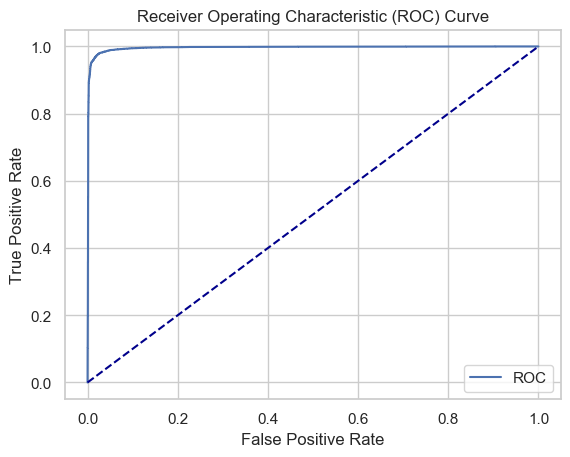

AUC: 0.996


In [25]:
from sklearn.svm import SVC
model_SVC_BvsF = SVC(C =  1, degree= 2, gamma= 1, kernel='rbf', probability=True)
fpr, tpr ,auc = roc(model_SVC_BvsF,X_train,y_train,X_test,y_test)

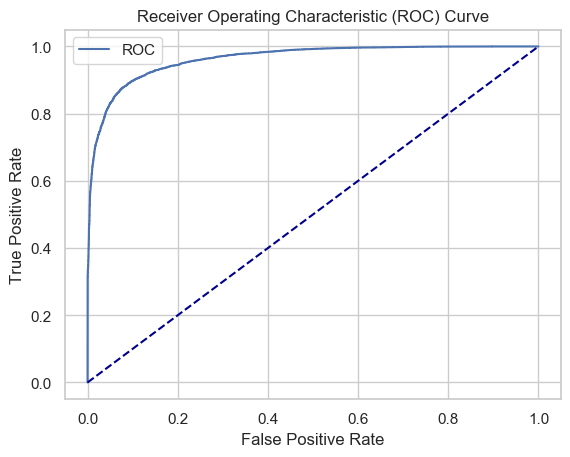

AUC: 0.963


In [27]:
from sklearn.ensemble import RandomForestClassifier
model_rf = RandomForestClassifier(criterion='gini', max_depth=9, min_samples_leaf=2, min_samples_split=6, n_estimators=100)

fpr, tpr ,auc = roc(model_rf,X_train,y_train,X_test,y_test)

In [29]:
model_SVC_BvsF = SVC(C =  1, degree= 2, gamma= 1, kernel='rbf')
model_SVC_BvsF.fit(X,y)

# Specify the file path where you want to save the model
file_path = 'model_SVC_BvsF.pkl'

# Use pickle to save the model to the specified file
with open(file_path, 'wb') as file:
    pickle.dump(model_SVC_BvsF, file)

print(f'Model saved to {file_path}')

Model saved to model_SVC_BvsF.pkl


In [28]:
model_rf_BvsF = RandomForestClassifier(criterion='gini', max_depth=9, min_samples_leaf=2, min_samples_split=6, n_estimators=100)
model_rf_BvsF.fit(X,y)

# Specify the file path where you want to save the model
file_path = 'model_rf_BvsF.pkl'

# Use pickle to save the model to the specified file
with open(file_path, 'wb') as file:
    pickle.dump(model_rf_BvsF, file)

print(f'Model saved to {file_path}')

Model saved to model_rf_BvsF.pkl


In [21]:
# Get the current directory (where your Python script is located)
current_directory = os.path.dirname('Baseline_Investigation')
# Initialize an empty list to store the rows
rows = []
# Iterate through all the JSON files in the specified range

# Generate the file name (assuming the format is POWxxx.json)
json_file_name = f'esperimento_0004_FV_.json'
print(json_file_name)
json_file_path =json_file_name;
# Check if the file exists before attempting to read it
if os.path.exists(json_file_path):
    print(json_file_name)
    with open(json_file_path, 'r') as json_file:
        data = json.load(json_file)

    # Iterate through the JSON data
    for key, value in data.items():
        user_id = value['UserID']
        readings = value['Readings']
        for reading_key, reading_value in readings.items():
            phase = reading_value['Phase']
            if phase in ["sudoku", "baseline"]:
                time = reading_value['Time']
                af3_theta = reading_value['AF3']['Theta']
                af3_alpha = reading_value['AF3']['Alpha']
                af3_betaL = reading_value['AF3']['BetaL']
                af3_betaH = reading_value['AF3']['BetaH']
                af3_gamma = reading_value['AF3']['Gamma']

                t7_theta = reading_value['T7']['Theta']
                t7_alpha = reading_value['T7']['Alpha']
                t7_betaL = reading_value['T7']['BetaL']
                t7_betaH = reading_value['T7']['BetaH']
                t7_gamma = reading_value['T7']['Gamma']

                pz_theta = reading_value['Pz']['Theta']
                pz_alpha = reading_value['Pz']['Alpha']
                pz_betaL = reading_value['Pz']['BetaL']
                pz_betaH = reading_value['Pz']['BetaH']
                pz_gamma = reading_value['Pz']['Gamma']

                t8_theta = reading_value['T8']['Theta']
                t8_alpha = reading_value['T8']['Alpha']
                t8_betaL = reading_value['T8']['BetaL']
                t8_betaH = reading_value['T8']['BetaH']
                t8_gamma = reading_value['T8']['Gamma']

                af4_theta = reading_value['AF4']['Theta']
                af4_alpha = reading_value['AF4']['Alpha']
                af4_betaL = reading_value['AF4']['BetaL']
                af4_betaH = reading_value['AF4']['BetaH']
                af4_gamma = reading_value['AF4']['Gamma']


                row = [user_id, phase, time, af3_theta, af3_alpha, af3_betaL, af3_betaH, af3_gamma, t7_theta, t7_alpha, t7_betaL, t7_betaH, t7_gamma,
                       pz_theta, pz_alpha, pz_betaL, pz_betaH, pz_gamma, t8_theta, t8_alpha, t8_betaL, t8_betaH, t8_gamma,
                       af4_theta, af4_alpha, af4_betaL, af4_betaH, af4_gamma]

                rows.append(row)

# Define columns as before
columns = ['UserID', 'Phase', 'Time', 'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma', 
           'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma', 
           'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma', 
           'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma', 
           'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma']

# Create a DataFrame from the rows and columns
df = pd.DataFrame(rows, columns=columns)

esperimento_0004_FV_.json
esperimento_0004_FV_.json


In [22]:
df

,UserID,Phase,Time,AF3_Theta,AF3_Alpha,AF3_BetaL,AF3_BetaH,AF3_Gamma,T7_Theta,T7_Alpha,...,T8_Theta,T8_Alpha,T8_BetaL,T8_BetaH,T8_Gamma,AF4_Theta,AF4_Alpha,AF4_BetaL,AF4_BetaH,AF4_Gamma
0,sub0006,baseline,10:12:20.913,8.55,2.242,0.604,0.635,0.178,45.11,15.06,...,5.938,4.562,3.412,11.918,12.103,8.577,2.334,1.112,0.699,0.18
1,sub0006,baseline,10:12:20.913,9.441,1.996,0.559,0.56,0.182,37.104,11.854,...,6.104,5.304,5.179,10.28,11.399,9.375,2.182,0.95,0.656,0.181
2,sub0006,baseline,10:12:20.913,9.542,1.788,0.547,0.507,0.192,28.34,8.948,...,6.503,6.719,7.711,8.429,10.676,9.42,2.003,0.831,0.636,0.194
3,sub0006,baseline,10:12:20.913,8.841,1.715,0.597,0.485,0.207,20.777,6.762,...,7.151,8.373,10.466,7.007,10.097,8.652,1.888,0.803,0.641,0.215
4,sub0006,baseline,10:12:20.913,7.58,1.837,0.718,0.497,0.222,15.611,5.556,...,7.928,9.717,12.683,6.49,9.68,7.3,1.914,0.868,0.665,0.239
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
490,sub0006,sudoku,10:14:17.452,2.578,0.97,0.882,0.435,0.129,3.975,0.748,...,2.954,1.916,3.765,14.98,8.438,3.071,1.497,0.807,0.399,0.105
491,sub0006,sudoku,10:14:17.452,2.409,0.852,0.834,0.422,0.121,3.574,0.832,...,2.65,1.71,3.997,17.838,7.655,2.675,1.418,0.665,0.412,0.108
492,sub0006,sudoku,10:14:17.452,2.378,0.75,0.827,0.477,0.122,2.979,0.951,...,2.307,1.648,3.975,19.633,6.885,2.46,1.311,0.559,0.464,0.12
493,sub0006,sudoku,10:14:17.452,2.65,0.677,0.826,0.569,0.133,2.45,1.08,...,2.061,1.81,3.732,19.838,6.442,2.609,1.175,0.477,0.543,0.14


In [23]:
column_to_drop = ['UserID','Time']
df = df.drop(column_to_drop, axis=1)

In [24]:
print(df.dtypes)

Phase        object
AF3_Theta    object
AF3_Alpha    object
AF3_BetaL    object
AF3_BetaH    object
AF3_Gamma    object
T7_Theta     object
T7_Alpha     object
T7_BetaL     object
T7_BetaH     object
T7_Gamma     object
Pz_Theta     object
Pz_Alpha     object
Pz_BetaL     object
Pz_BetaH     object
Pz_Gamma     object
T8_Theta     object
T8_Alpha     object
T8_BetaL     object
T8_BetaH     object
T8_Gamma     object
AF4_Theta    object
AF4_Alpha    object
AF4_BetaL    object
AF4_BetaH    object
AF4_Gamma    object
dtype: object


In [25]:
columns_to_convert = [
    'AF3_Theta', 'AF3_Alpha', 'AF3_BetaL', 'AF3_BetaH', 'AF3_Gamma',
    'T7_Theta', 'T7_Alpha', 'T7_BetaL', 'T7_BetaH', 'T7_Gamma',
    'Pz_Theta', 'Pz_Alpha', 'Pz_BetaL', 'Pz_BetaH', 'Pz_Gamma',
    'T8_Theta', 'T8_Alpha', 'T8_BetaL', 'T8_BetaH', 'T8_Gamma',
    'AF4_Theta', 'AF4_Alpha', 'AF4_BetaL', 'AF4_BetaH', 'AF4_Gamma'
]

# Use the astype method to convert columns to float
df[columns_to_convert] = df[columns_to_convert].astype(float)

In [26]:
print(df.dtypes)

Phase         object
AF3_Theta    float64
AF3_Alpha    float64
AF3_BetaL    float64
AF3_BetaH    float64
AF3_Gamma    float64
T7_Theta     float64
T7_Alpha     float64
T7_BetaL     float64
T7_BetaH     float64
T7_Gamma     float64
Pz_Theta     float64
Pz_Alpha     float64
Pz_BetaL     float64
Pz_BetaH     float64
Pz_Gamma     float64
T8_Theta     float64
T8_Alpha     float64
T8_BetaL     float64
T8_BetaH     float64
T8_Gamma     float64
AF4_Theta    float64
AF4_Alpha    float64
AF4_BetaL    float64
AF4_BetaH    float64
AF4_Gamma    float64
dtype: object


In [27]:
# Apply logarithm
df.loc[:, columns_to_convert] = df.loc[:, columns_to_convert].apply(lambda x: x.apply(lambda y: math.log(y + 1)))

In [28]:
 baseline_rows = df[df['Phase'] == 'baseline']
if baseline_rows.empty:
    print(f"No 'baseline' rows")  
averages = baseline_rows[columns_to_convert].mean()

# Subtract the average value from each column, for rows with the current user ID
for column in columns_to_convert:
    df.loc[:, column] -= averages[column]

In [29]:
df

,Phase,AF3_Theta,AF3_Alpha,AF3_BetaL,AF3_BetaH,AF3_Gamma,T7_Theta,T7_Alpha,T7_BetaL,T7_BetaH,...,T8_Theta,T8_Alpha,T8_BetaL,T8_BetaH,T8_Gamma,AF4_Theta,AF4_Alpha,AF4_BetaL,AF4_BetaH,AF4_Gamma
0,baseline,0.475658,-0.849562,-0.508507,-0.097332,-0.139465,0.346086,-0.080084,-0.087337,-0.086137,...,0.387430,-0.386410,-0.783835,0.474296,0.763947,0.576638,-0.878561,-0.295533,-0.111909,-0.161474
1,baseline,0.564858,-0.928475,-0.536962,-0.144289,-0.136076,0.155375,-0.302760,-0.335911,-0.138549,...,0.411074,-0.261183,-0.447006,0.338706,0.708722,0.656672,-0.925224,-0.375339,-0.137543,-0.160626
2,baseline,0.574485,-1.000428,-0.544690,-0.178854,-0.127651,-0.105992,-0.559044,-0.655653,-0.194512,...,0.465719,-0.058683,-0.103576,0.159465,0.648642,0.661000,-0.983122,-0.438306,-0.149694,-0.149679
3,baseline,0.505675,-1.026961,-0.512880,-0.193560,-0.115146,-0.404090,-0.807175,-0.977298,-0.279235,...,0.548557,0.135466,0.171223,-0.004009,0.597781,0.584439,-1.022170,-0.453716,-0.146643,-0.132244
4,baseline,0.368551,-0.983005,-0.439846,-0.185511,-0.102795,-0.674879,-0.976035,-1.207267,-0.391713,...,0.639609,0.269464,0.347991,-0.070757,0.559479,0.433529,-1.013207,-0.418300,-0.132123,-0.112683
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
490,sudoku,-0.506079,-1.347719,-0.348672,-0.227810,-0.181951,-1.880519,-2.297943,-1.156994,-0.789273,...,-0.174856,-1.032155,-0.706865,0.687013,0.435850,-0.278838,-1.167644,-0.451500,-0.306191,-0.227143
491,sudoku,-0.554464,-1.409487,-0.374508,-0.236910,-0.189062,-1.964556,-2.251007,-1.048236,-0.789273,...,-0.254856,-1.105419,-0.659325,0.851551,0.349243,-0.381174,-1.199793,-0.533343,-0.296941,-0.224431
492,sudoku,-0.563599,-1.466137,-0.378332,-0.198961,-0.188171,-2.103913,-2.188073,-0.984354,-0.784168,...,-0.353542,-1.128563,-0.663738,0.942566,0.256068,-0.441458,-1.245054,-0.599123,-0.260776,-0.213659
493,sudoku,-0.486155,-1.508746,-0.378879,-0.138536,-0.178415,-2.246570,-2.124048,-0.970291,-0.791244,...,-0.430842,-1.069183,-0.713815,0.952453,0.198246,-0.399296,-1.305706,-0.653155,-0.208220,-0.195960


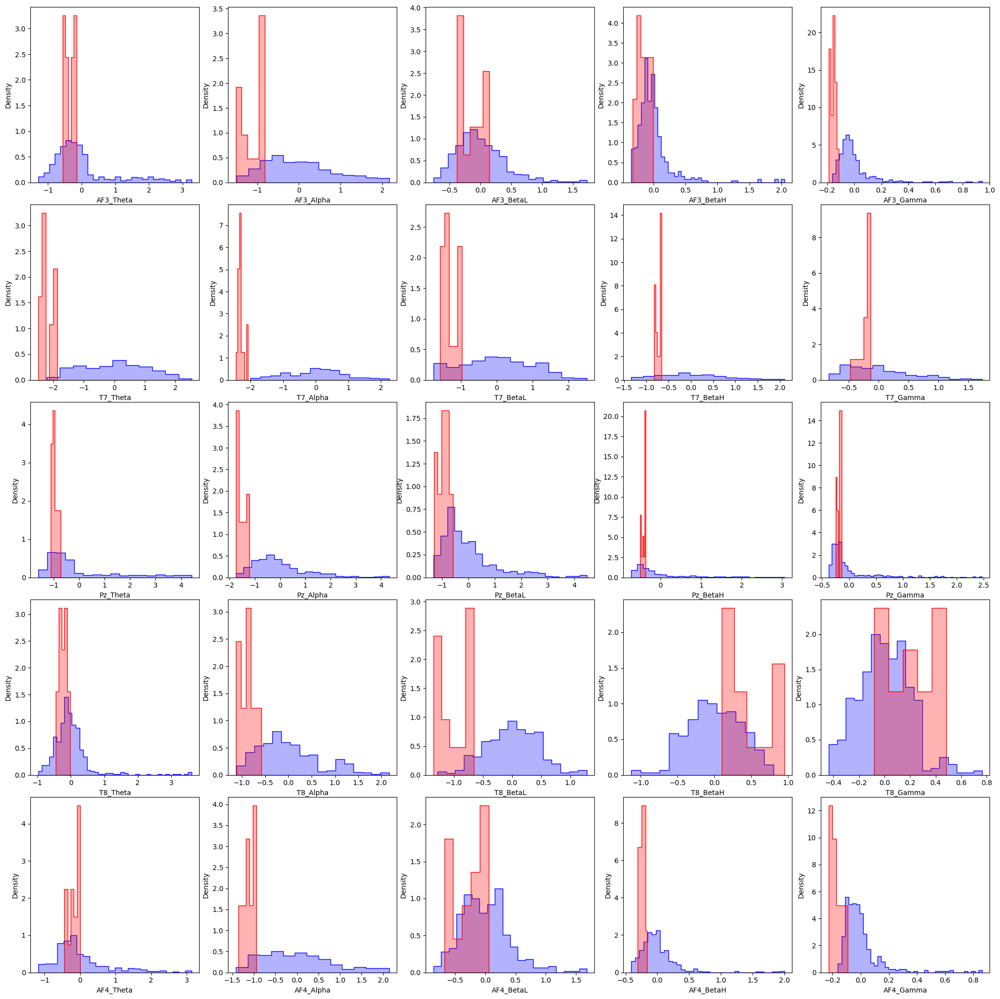

In [30]:
df_feat = df[columns_to_convert]


X0 = df_feat[df['Phase']=='baseline']
X1 = df_feat[df['Phase']=='sudoku']

fig, axes = plt.subplots(ncols=5, nrows=5, figsize=(20,20))
fig.tight_layout()

for i, ax in zip(range(df_feat.columns.size), axes.flat):
    sns.histplot(X0.iloc[:,i], color="blue", ax=ax, stat='density', element="step",  alpha=0.3)
    sns.histplot(X1.iloc[:,i], color="red",  ax=ax,stat='density', element="step",  alpha=0.3)
plt.show()

In [31]:
X_val =df[columns_to_convert] 
print(X_val.shape)
y_val = (df['Phase']=='sudoku').astype(int)
print(len(y_val))
print(y_val.value_counts())

(495, 25)
495
0    480
1     15
Name: Phase, dtype: int64


In [32]:
with open('Modelli_BaselineSubtraction/model_SVC_BvsF.pkl', 'rb') as file:
    model_SVC_BvsF = pickle.load(file)
    
    
y_pred = model_SVC_BvsF.predict(X_val)

# Evaluate the performance of the model
accuracy = accuracy_score(y_val, y_pred)
classification_report_str = classification_report(y_val, y_pred)

# Display the results
print(f"Accuracy: {accuracy:.4f}")
print("Classification Report:")
print(classification_report_str)

Accuracy: 0.2889
Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.27      0.42       480
           1       0.04      1.00      0.08        15

    accuracy                           0.29       495
   macro avg       0.52      0.63      0.25       495
weighted avg       0.97      0.29      0.41       495



Text(0.5, 0, 'Permutation Importance')

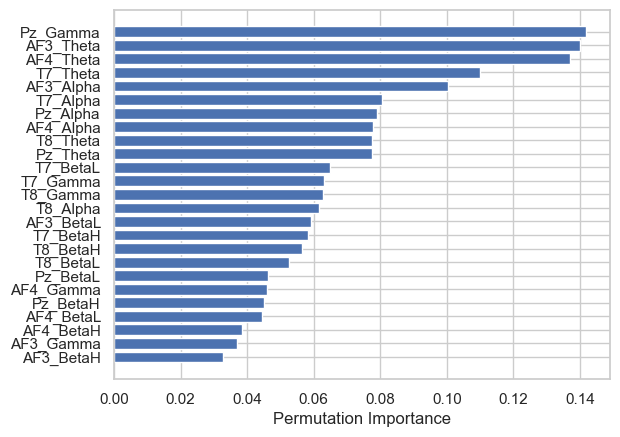

In [143]:
from sklearn.inspection import permutation_importance
perm_importance = permutation_importance(model_SVC_BvsF, X, y)

feature_names = columns_to_convert
features = np.array(feature_names)

sorted_idx = perm_importance.importances_mean.argsort()
plt.barh(features[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel("Permutation Importance")